In [1]:
!pip install scipy h5py opencv-python-headless


In [2]:
import os
import cv2
import h5py
import torch
import scipy.io as sio
import numpy as np
import torch.nn as nn
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, models

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


In [3]:
import scipy

In [37]:
def generate_density_map(image_shape, points, sigma=15):
    h, w = image_shape
    density = np.zeros((h, w), dtype=np.float32)
    for point in points:
        x = min(w - 1, max(0, int(round(point[0]))))
        y = min(h - 1, max(0, int(round(point[1]))))
        density[y, x] += 1
    density = cv2.GaussianBlur(density, (0, 0), sigma)
    return density


In [38]:
def extract_points(mat):
    if 'annPoints' in mat:
        return mat['annPoints']
    elif 'image_info' in mat:
        points_raw = mat['image_info'][0,0][0,0][0]
        return np.array([[float(p[0]), float(p[1])] for p in points_raw])
    return np.empty((0, 2))


In [39]:
class CrowdDataset(Dataset):
    def __init__(self, img_dir, gt_dir, transform=None, target_size=(384, 512), density_size=(48, 64)):
        self.img_dir = img_dir
        self.gt_dir = gt_dir
        self.img_files = sorted([f for f in os.listdir(img_dir) if f.endswith('.jpg')])
        self.transform = transform
        self.target_size = target_size
        self.density_size = density_size

    def __len__(self):
        return len(self.img_files)

    def __getitem__(self, idx):
        img_name = self.img_files[idx]
        img_path = os.path.join(self.img_dir, img_name)
        gt_path = os.path.join(self.gt_dir, 'GT_' + img_name.replace('.jpg', '.mat'))

        # Load and resize image
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (self.target_size[1], self.target_size[0]))

        # Transform image
        if self.transform:
            img = self.transform(img)
        else:
            img = torch.from_numpy(img.transpose((2, 0, 1))).float() / 255.0

        # Load and generate density map
        mat = scipy.io.loadmat(gt_path)
        points = extract_points(mat)

        density_map = generate_density_map(self.target_size, points, sigma=11)
        original_sum = density_map.sum()

        # Resize to model output size and preserve total count
        density_map = cv2.resize(density_map, (self.density_size[1], self.density_size[0]), interpolation=cv2.INTER_CUBIC)
        if density_map.sum() > 0 and original_sum > 0:
            density_map *= (original_sum / density_map.sum())

        density_map = torch.from_numpy(density_map).unsqueeze(0).float()

        return img, density_map

       


In [40]:
class SFCN(nn.Module):
    def __init__(self):
        super(SFCN, self).__init__()
        self.features = models.vgg16_bn(weights=models.VGG16_BN_Weights.DEFAULT).features[:33]
        self.regressor = nn.Sequential(
            nn.Conv2d(512, 256, 3, padding=1), nn.ReLU(inplace=True),
            nn.Conv2d(256, 128, 3, padding=1), nn.ReLU(inplace=True),
            nn.Conv2d(128, 64, 3, padding=1), nn.ReLU(inplace=True),
            nn.Conv2d(64, 1, 1)
        )

    def forward(self, x):
        x = self.features(x)
        x = self.regressor(x)
        return x


In [41]:
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

train_dataset = CrowdDataset(
    "/kaggle/input/crowd-dataset/crowd_wala_dataset/train_data/images",
    "/kaggle/input/crowd-dataset/crowd_wala_dataset/train_data/ground_truth",
    transform
)

val_dataset = CrowdDataset(
    "/kaggle/input/crowd-dataset/crowd_wala_dataset/test_data/images",
    "/kaggle/input/crowd-dataset/crowd_wala_dataset/test_data/ground_truth",
    transform
)

train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=4, shuffle=False)


In [43]:
model = SFCN().to(device)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)

for epoch in range(1, 21):
    model.train()
    train_loss = 0.0
    for imgs, gts in train_loader:
        imgs, gts = imgs.to(device), gts.to(device)
        preds = model(imgs)
        loss = criterion(preds, gts)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        train_loss += loss.item()

    model.eval()
    total_mae = 0.0
    with torch.no_grad():
        for imgs, gts in val_loader:
            imgs, gts = imgs.to(device), gts.to(device)
            preds = model(imgs)
            mae = torch.abs(preds.sum() - gts.sum()).item()
            total_mae += mae

    print(f"Epoch {epoch}: Train Loss = {train_loss / len(train_loader):.4f}, Val MAE = {total_mae / len(val_loader):.2f}")

# Save to working directory (persistent in Kaggle sessions)
torch.save(model.state_dict(), "/kaggle/working/sfcn_crowd_count.pth")



Epoch 1: Train Loss = 0.0180, Val MAE = 143.87
Epoch 2: Train Loss = 0.0153, Val MAE = 152.22
Epoch 3: Train Loss = 0.0148, Val MAE = 180.68
Epoch 4: Train Loss = 0.0140, Val MAE = 219.00
Epoch 5: Train Loss = 0.0131, Val MAE = 214.89
Epoch 6: Train Loss = 0.0116, Val MAE = 89.11
Epoch 7: Train Loss = 0.0107, Val MAE = 128.29
Epoch 8: Train Loss = 0.0122, Val MAE = 138.89
Epoch 9: Train Loss = 0.0103, Val MAE = 126.91
Epoch 10: Train Loss = 0.0100, Val MAE = 161.36
Epoch 11: Train Loss = 0.0085, Val MAE = 210.40
Epoch 12: Train Loss = 0.0076, Val MAE = 268.19
Epoch 13: Train Loss = 0.0085, Val MAE = 285.67
Epoch 14: Train Loss = 0.0076, Val MAE = 201.56
Epoch 15: Train Loss = 0.0082, Val MAE = 235.70
Epoch 16: Train Loss = 0.0064, Val MAE = 193.84
Epoch 17: Train Loss = 0.0057, Val MAE = 137.58
Epoch 18: Train Loss = 0.0056, Val MAE = 84.04
Epoch 19: Train Loss = 0.0053, Val MAE = 102.20
Epoch 20: Train Loss = 0.0053, Val MAE = 77.30


In [36]:
# Save to working directory (persistent in Kaggle sessions)
torch.save(model.state_dict(), "/kaggle/working/sfcn_crowd_count.pth")




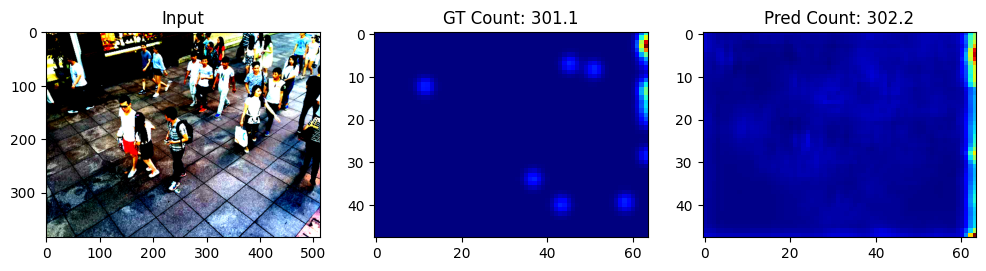

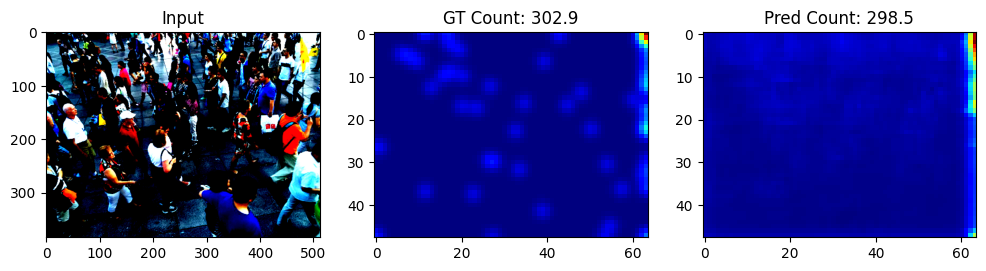

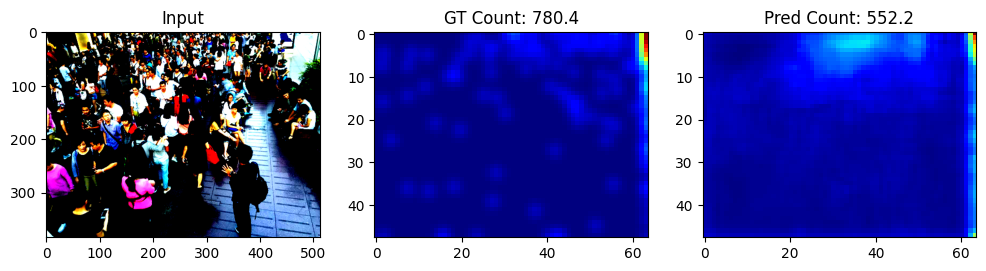

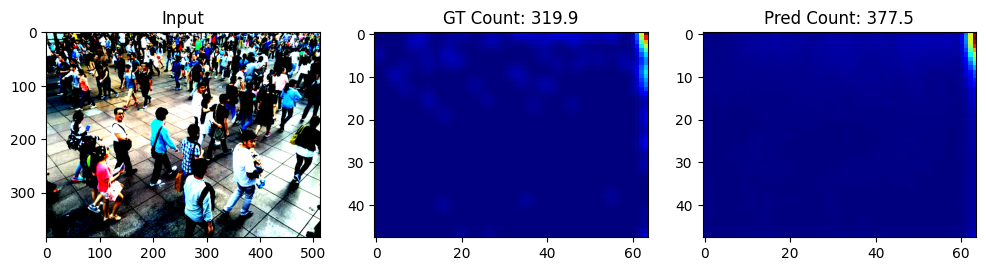

In [44]:
model.eval()
with torch.no_grad():
    for i, (img, gt) in enumerate(val_loader):
        if i == 4: break
        img = img.to(device)
        pred = model(img)

        plt.figure(figsize=(12, 4))
        plt.subplot(1, 3, 1)
        plt.imshow(img[0].cpu().permute(1, 2, 0))
        plt.title("Input")

        plt.subplot(1, 3, 2)
        plt.imshow(gt[0][0].cpu(), cmap='jet')
        plt.title(f"GT Count: {gt.sum().item():.1f}")

        plt.subplot(1, 3, 3)
        plt.imshow(pred[0][0].cpu(), cmap='jet')
        plt.title(f"Pred Count: {pred.sum().item():.1f}")
        plt.show()


In [45]:
import cv2
from torchvision.transforms.functional import to_tensor, normalize

# Load trained model
model = SFCN().to(device)
model.load_state_dict(torch.load("sfcn_crowd_count.pth", map_location=device))
model.eval()

# Open video
video_path = "/kaggle/input/test-video/1 2.mp4"
cap = cv2.VideoCapture(video_path)

# Output settings
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter("output_counted_video.mp4", fourcc, cap.get(cv2.CAP_PROP_FPS),
                      (int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)), int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))))

# Process each frame
with torch.no_grad():
    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        orig_frame = frame.copy()
        h, w = 384, 512
        frame_resized = cv2.resize(frame, (w, h))
        frame_rgb = cv2.cvtColor(frame_resized, cv2.COLOR_BGR2RGB)
        frame_tensor = to_tensor(frame_rgb).to(device)
        frame_tensor = normalize(frame_tensor, [0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
        frame_tensor = frame_tensor.unsqueeze(0)

        pred_density = model(frame_tensor)
        count = pred_density.sum().item()

        # Draw count on original frame
        text = f"Count: {int(round(count))}"
        cv2.putText(orig_frame, text, (30, 50), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (0, 255, 0), 3)

        out.write(orig_frame)

cap.release()
out.release()
print("✅ Output saved as output_counted_video.mp4")


✅ Output saved as output_counted_video.mp4


In [32]:
from IPython.display import Video

Video("output_counted_video.mp4", embed=True)


In [46]:
from IPython.display import FileLink
FileLink("output_counted_video.mp4")


/kaggle/working/output_counted_video.mp4

In [48]:
import cv2
from torchvision.transforms.functional import to_tensor, normalize
from IPython.display import Video as IPyVideo

# Load model
model = SFCN().to(device)
model.load_state_dict(torch.load("/kaggle/working/sfcn_crowd_count.pth", map_location=device))
model.eval()
print(" Model loaded!")

# Open video
video_path = "/kaggle/input/testvid/test.mp4"
cap = cv2.VideoCapture(video_path)

if not cap.isOpened():
    raise ValueError("Video file could not be opened. Check path.")

frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = cap.get(cv2.CAP_PROP_FPS)

out = cv2.VideoWriter("output_counted_video.mp4",
                      cv2.VideoWriter_fourcc(*'mp4v'),
                      fps,
                      (frame_width, frame_height))

# Process frames
with torch.no_grad():
    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        frame_resized = cv2.resize(frame, (512, 384))
        frame_rgb = cv2.cvtColor(frame_resized, cv2.COLOR_BGR2RGB)
        img_tensor = to_tensor(frame_rgb).to(device)
        img_tensor = normalize(img_tensor, [0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
        img_tensor = img_tensor.unsqueeze(0)

        pred = model(img_tensor)
        count = int(pred.sum().item())

        # Draw on original frame (not resized)
        display_frame = frame.copy()
        cv2.putText(display_frame, f"Count: {count}", (30, 50),
                    cv2.FONT_HERSHEY_SIMPLEX, 1.5, (0, 255, 0), 3)
        out.write(display_frame)

cap.release()
out.release()
print(" Video saved as output_counted_video.mp4")


✅ Model loaded!
✅ Video saved as output_counted_video.mp4


In [49]:
from IPython.display import FileLink
FileLink("output_counted_video.mp4")


/kaggle/working/output_counted_video.mp4

In [50]:
torch.save(model.state_dict(), "/kaggle/working/sfcn_crowd_count.pth")


In [51]:
from IPython.display import FileLink
FileLink("/kaggle/working/sfcn_crowd_count.pth")


/kaggle/working/sfcn_crowd_count.pth

In [52]:
import shutil

# Make sure it's in the correct location
model_path = "/kaggle/working/sfcn_crowd_count.pth"

# Move it to /kaggle/outputs (this helps it show in UI)
shutil.copy(model_path, "/kaggle/working/sfcn_crowd_count_download.pth")


'/kaggle/working/sfcn_crowd_count_download.pth'

In [53]:
from IPython.display import FileLink
FileLink("/kaggle/working/sfcn_crowd_count_download.pth")


/kaggle/working/sfcn_crowd_count_download.pth